In [1]:
#### Requires MDL fork of genomeview found at: https://github.com/MethodsDev/genomeview

import genomeview
from genomeview.convenience import Configuration
import ipywidgets as widgets
import io
import os

## Setup BAM alignments and reference file paths

In [2]:
human_genome_path = "/Users/cgeorges/Work/mdl-refs/GRCh38/GRCh38_no_alt.fa"
human_gtf_path = "/Users/cgeorges/Work/mdl-refs/GRCh38/GRCh38.gencode.v39.annotation.gtf.gz"

human_bed_gencode = "/Users/cgeorges/Work/mdl-refs/GRCh38/GRCh38.gencode.v39.annotation.sorted.bed.gz"

human_bed_paths = {
    "gencode": "/Users/cgeorges/Work/mdl-refs/GRCh38/GRCh38.gencode.v39.annotation.sorted.bed.gz",
    "ref_TSS": "/Users/cgeorges/Work/mdl-refs/GRCh38/refTSS_v4.1_human_coordinate.hg38.bed.gz"
}


In [3]:
mouse_genome_path = "/Users/cgeorges/Work/mdl-refs/GRCm39_M32/GRCm39.primary_assembly.genome.fa.gz"
mouse_gtf_path = "/Users/cgeorges/Work/mdl-refs/GRCm39_M32/gencode.vM32.annotation.gtf.gz"

mouse_bed_gencode = "/Users/cgeorges/Work/mdl-refs/GRCm39_M32/gencode.vM32.annotation.bed.gz"

mouse_bed_paths_dict = {
    "gencode": "/Users/cgeorges/Work/mdl-refs/GRCm39_M32/gencode.vM32.annotation.bed.gz",
    "PFAM_cds": "/Users/cgeorges/Work/genomeview_tests/annotation_results/gencode.vM32_pfam_predictions_with_cds.sorted.bed.gz",
    "PFAM_only": "/Users/cgeorges/Work/genomeview_tests/annotation_results/gencode.vM32_pfam_predictions.sorted.bed.gz"
}

mouse_bed_paths_list = ["/Users/cgeorges/Work/mdl-refs/GRCm39_M32/gencode.vM32.annotation.bed.gz",
                        "/Users/cgeorges/Work/genomeview_tests/mouse_pfam_predictions_test_conversion.only_domains.sorted.bed.gz"]

In [4]:
human_bam_list = {"6_RT_RT":"/Users/cgeorges/Work/nEXTend/bams/m64387e_231005_184936.callao.6.classified.non_proper.cdna.aligned.bam",
#                "7_RT_RT":"/Users/cgeorges/Work/nEXTend/bams/m64387e_231005_184936.callao.7.classified.non_proper.cdna.aligned.bam",
#                "8_RT_RT":"/Users/cgeorges/Work/nEXTend/bams/m64387e_231005_184936.callao.8.classified.non_proper.cdna.aligned.bam",
                "6_proper":"/Users/cgeorges/Work/nEXTend/bams/m64387e_231005_184936.callao.6.classified.proper.cdna.aligned.bam",
#                "7_proper":"/Users/cgeorges/Work/nEXTend/bams/m64387e_231005_184936.callao.7.classified.proper.cdna.aligned.bam",
#                "8_proper":"/Users/cgeorges/Work/nEXTend/bams/m64387e_231005_184936.callao.8.classified.proper.cdna.aligned.bam"
}

In [5]:
mouse_bam_list = {"bc05": "/Users/cgeorges/Work/collab-sameer-aryal/aligned_bams/m84173_231121_000151_s4.bc05.aligned.sorted.bam",
                  "bc10": "/Users/cgeorges/Work/collab-sameer-aryal/aligned_bams/m84173_231121_000151_s4.bc10.aligned.sorted.bam"
                 }

### Setup the configuration for the genome of interest

In [6]:
%%time
human_ref = Configuration(genome_fasta = human_genome_path,
                          bed_annotation = human_bed_paths,
                          gtf_annotation = human_gtf_path
                         )

CPU times: user 42.8 s, sys: 582 ms, total: 43.4 s
Wall time: 43.4 s


In [7]:
%%time
mouse_ref = Configuration(genome_fasta = mouse_genome_path,
                          bed_annotation = mouse_bed_gencode,
                          gtf_annotation = mouse_gtf_path
                         )

CPU times: user 27.7 s, sys: 448 ms, total: 28.1 s
Wall time: 28.2 s


# Generate view for feature of interest (by gene or transcript ID)

In [8]:
# unprocessed pseudogene, protein_coding, protein coding, protein coding
example_human_genes = ["ENSG00000227232.5", "ENSG00000188976.11", "ENSG00000131591.18", "ENSG00000162576.17"]

# 2 isoforms of "ENSG00000162576.17" (last example gene)
example_human_transcripts = ["ENSG00000162576.17", "ENST00000474033.5"]

### Example with all default settings

/Users/cgeorges/Work/github/genomeview/genomeview/graphtrack.py:69: RuntimeWarning: invalid value encountered in scalar divide
  return self.height - ((yval - self.min_y) / height * (self.height-2*self.ymargin) + self.ymargin)


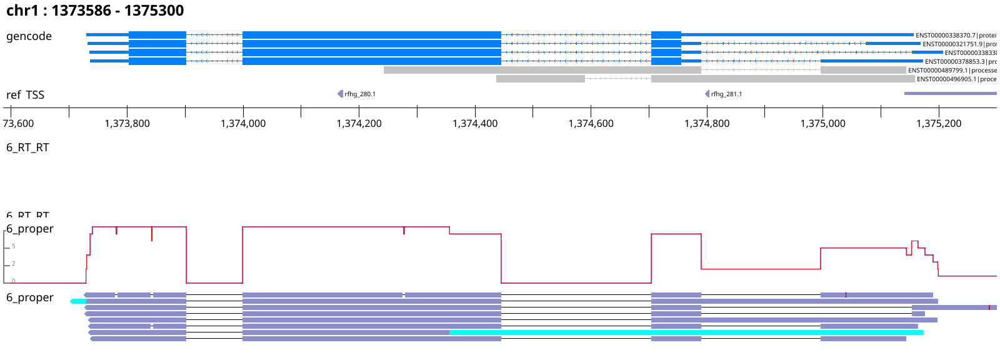

In [9]:
human_ref.plot_feature("ENST00000338370.7", bams_dict=human_bam_list, padding_perc = 0.1)

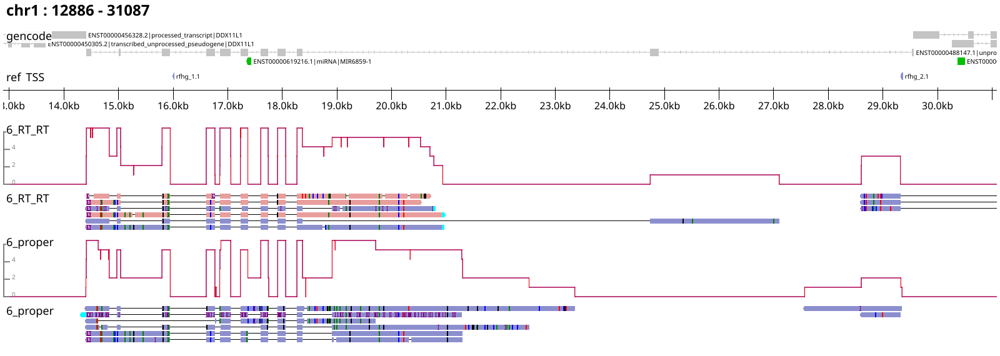

In [10]:
human_ref.plot_feature(example_human_genes[0], bams_dict=human_bam_list)

/Users/cgeorges/Work/github/genomeview/genomeview/quickconsensus.py:70: RuntimeWarning: invalid value encountered in divide
  elif ((this_type / total) > 0.2).any():


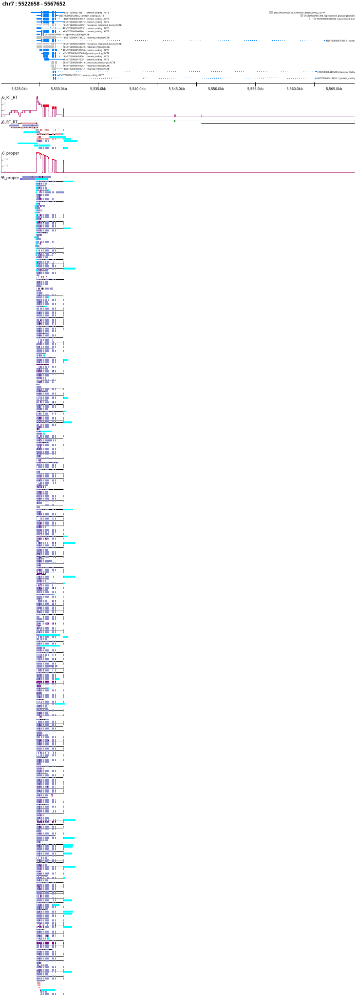

In [11]:
human_ref.update_bed(human_bed_gencode)
human_ref.plot_feature("ACTB", bams_dict=human_bam_list)

In [12]:
# mouse_ref.plot_feature("ENSMUSG00000025903.15", bams_dict=mouse_bam_list)
# mouse_ref.plot_exons("ENSMUSG00000025903.15", bams_dict=mouse_bam_list)
# mouse_ref.plot_exons("ENSMUSG00000025903.15", bams_dict=mouse_bam_list, as_widget=True)

# mouse_ref.plot_feature("ENSMUSG00000033845.14", bams_dict=mouse_bam_list)
# mouse_ref.plot_exons("ENSMUSG00000033845.14", bams_dict=mouse_bam_list)
# mouse_ref.plot_splice_junctions("ENSMUSG00000033845.14", bams_dict=mouse_bam_list, tighter_track=True, as_widget=True)

# mouse_ref.plot_exons("ENSMUST00000130201.8", bams_dict=mouse_bam_list, tighter_track=True)
# mouse_ref.plot_exons("ENSMUST00000130201.8", bams_dict=mouse_bam_list, tighter_track=True, as_widget=True)

# mouse_ref.plot_exons("ENSMUSG00000067851.12", bams_dict=mouse_bam_list)
# mouse_ref.plot_exons("ENSMUSG00000067851.12", bams_dict=mouse_bam_list, N_per_row=3)
# mouse_ref.plot_exons("ENSMUSG00000067851.12", bams_dict=mouse_bam_list, as_widget=True)

# mouse_ref.plot_exons("Pcyt2", bams_dict=mouse_bam_list, padding_perc=0.1)
# mouse_ref.plot_exons("Pcyt2", bams_dict=mouse_bam_list, padding_perc=0.1, tighter_track=True)
mouse_ref.update_bed(mouse_bed_paths_dict)
# mouse_ref.plot_exons("Pcyt2", bams_dict=mouse_bam_list, padding_perc=0.1, view_width=4000, tighter_track=True, as_widget=True)
mouse_ref.plot_exons("Rb1cc1", bams_dict=mouse_bam_list, padding_perc=0.1, view_width=4000, tighter_track=True, as_widget=True)

In [13]:
mouse_ref.plot_exons("Pcyt2", bams_dict=mouse_bam_list, padding_perc=0.1, view_width=4000, tighter_track=True)

In [14]:
mouse_ref.plot_read("m84173_231121_000151_s4/164172203/ccs/9580_11097", mouse_bam_list['bc05'])

In [15]:
genomeview.export.save_html_view(mouse_ref.plot_read("m84173_231121_000151_s4/164172203/ccs/9580_11097", mouse_bam_list['bc05']), "/Users/cgeorges/Work/tmp/mouse_read_genomeview.html")

In [16]:
doc = mouse_ref.plot_exons("ENSMUSG00000067851.12", bams_dict=mouse_bam_list)
genomeview.save(doc, "/Users/cgeorges/Work/tmp/ENSMUSG00000067851.12.svg")
genomeview.save(doc, "/Users/cgeorges/Work/tmp/ENSMUSG00000067851.12.png")

### Example with some additional options changed

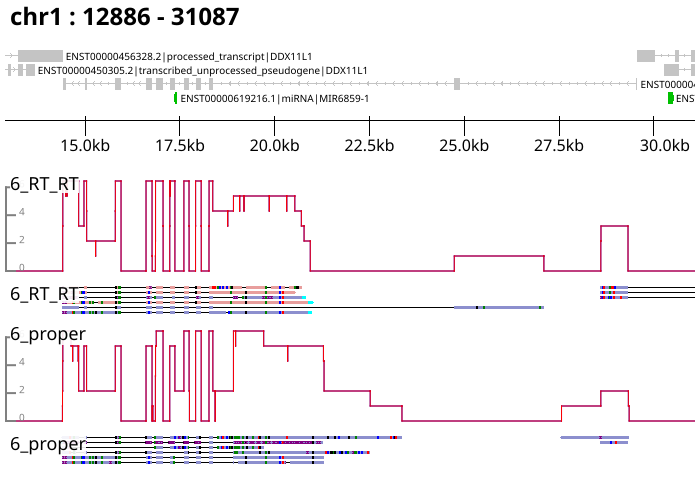

In [17]:
human_ref.plot_feature(example_human_genes[0], bams_dict=human_bam_list, view_width=700, tighter_track=True)

In [18]:
human_ref.plot_features(example_human_genes, bams_dict=human_bam_list)

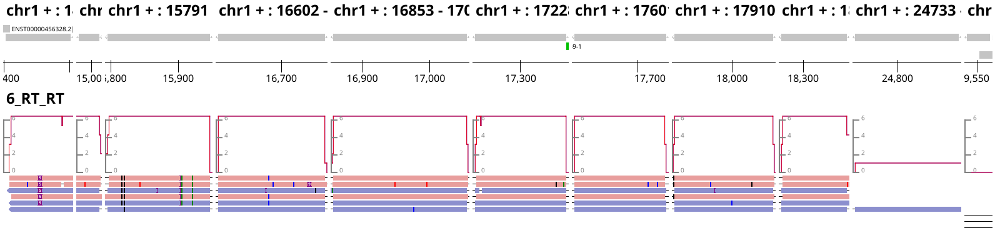

In [19]:
human_ref.plot_exons(example_human_genes[0], bams_dict={"6_RT_RT":"/Users/cgeorges/Work/nEXTend/bams/m64387e_231005_184936.callao.6.classified.non_proper.cdna.aligned.bam"})

In [20]:
human_ref.plot_exons(example_human_genes[0], bams_dict=human_bam_list, as_widget=True)

In [21]:
human_ref.plot_splice_junctions(example_human_genes[0], bams_dict=human_bam_list, as_widget=True)